### Network Visualization
Course: Introduction to Network Science, Fall 2021

Author: Jin-Zhu Yu and Chenheng Jiang

Instructor: Prof. Jianxi Gao

Department of Computer Science

Rensselaer Polytechnic Institute (RPI)

September 17, 2021

**Summary:** We will learn how to use ```graph_tool``` in conjuction with ```networkx``` to visualize networks.

## Install graph_tool and networkX


**Source:** https://graph-tool.skewed.de/

**Note:** It is not available for Windows. You may want to install wsl (Windows Subsystem for Linux) following the instructions [here](https://docs.microsoft.com/en-us/windows/wsl/install-win10) and GWSL ("an XServer that lets you easily run graphical Linux apps on Windows 10") available [here](https://www.microsoft.com/en-us/p/gwsl/9nl6kd1h33v3#activetab=pivot:overviewtab).


```Conda installation (GNU/Linux|MacOS)```

```conda create --name gt -c conda-forge graph-tool```

```conda activate gt```

Open Jupyter notebook within the ```gt``` virtual environment:

```jupyter notebook --notebook-dir=[your dir to src]```


**Note:** You may need to install pandas and networkX as well to the ```gt``` virtual environment.

```conda install -c anaconda pandas```

```conda install -c anaconda networkx```
 

**Reference:** Peixoto, T. P. (2014). The graph-tool python library. figshare.

After installation, go back to the ```gt``` virtual environement and run the following within jupyter-notebook as a test

```import graph_tool.all as gt```

```import networkx as nx```

In [1]:
import os
import sys
import math
import pickle
import random

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt

from IPython.display import Image

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

#### Set up the default figure format

In [2]:
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times'
plt.rcParams['font.weight'] = 'bold'
plt.rcParams['font.size'] = 20

plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'white'

plt.rcParams['text.usetex'] = True
plt.rcParams['text.latex.preamble'] = [r'\usepackage{amsmath}']
plt.rcParams["mathtext.fontset"] = 'cm'
plt.rcParams['axes.labelsize'] = 20
# plt.rcParams['axes.labelweight'] = 'bold'
    
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['lines.markeredgewidth'] = 2

plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['xtick.minor.visible'] = True
plt.rcParams['xtick.major.size'] = 8
plt.rcParams['xtick.major.width'] = 1.1
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.right'] = False
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['ytick.labelsize'] = 20
plt.rcParams['ytick.minor.visible'] = True
plt.rcParams['ytick.major.size'] = 8
plt.rcParams['ytick.major.width'] = 1.1

plt.rcParams['savefig.dpi'] = 200  # typically >= 500. Reduced here to open and view the graph quicker.


#### Import packages for network visualization

In [3]:
# import graph_tool.all as gt
from graph_tool import *
import graph_tool.all as gt
import networkx as nx

#### Change directory

In [4]:
path = '../data/'
os.chdir(path)

In [5]:
# create one if it does not exist
# if not os.path.exists(path):
#     os.makedirs(path)

# os.getcwd()

### A taste of NetworkX

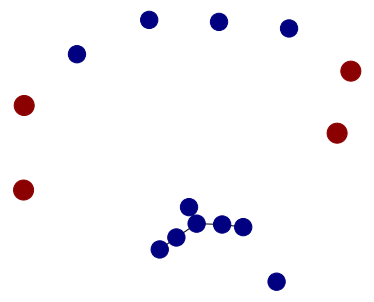

In [6]:
# create a graph
G = nx.Graph()
# use the following for directed graph
# DG = nx.DiGraph()

# add nodes
G.add_node(1) 
G.add_nodes_from([2, 3])
G.add_nodes_from(list(range(3,9)))

G1 = nx.complete_graph(15)
G.add_nodes_from(G1)

# add edges
G.add_edges_from([(1, 3), (2, 4), (6,7), (1,6), (6,4)])

# draw
# specify color, size
color_map = ['darkred' if node>10 else 'navy' for node in G]
node_size = [400 if node >10 else 300 for node in G]
# node_shape= ['d' if node >10 else 's' for node in G]

plt.figure(figsize=(5,4))
nx.draw(G, node_size = node_size, node_color=color_map) 

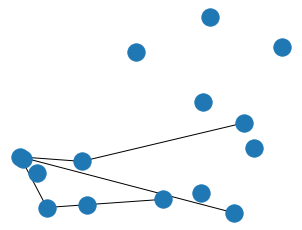

In [7]:
plt.figure(figsize=(4,3))
nx.draw_random(G)

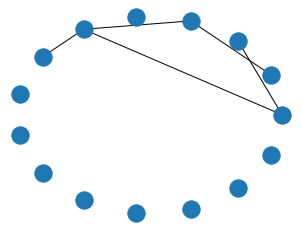

In [8]:
plt.figure(figsize=(4,3)) 
nx.draw_circular(G)

In [9]:
# return list of nodes
node_list = list(G.nodes)

# return number of nodes
n_node = G.number_of_nodes()

In [10]:
#return connected components
Gcs = nx.connected_components(G)

#return the largest connected component
Gc = G.subgraph(max(Gcs, key=len))

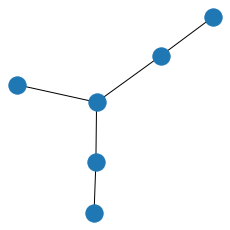

In [11]:
# plot
plt.figure(figsize=(3,3)) 
nx.draw_spring(Gc)
plt.show()

### Random Networks

### Exercise 1
1) Draw an undirected random network with 30 node and a desired probability of edges of 0.1 and 0.2 using ```nx.erdos_renyi_graph(n, p, seed=None, directed=False)```. Use seed = 2021.

2) Use the spring layout.

3) Set the color of first 20 nodes to green the rest blue and the size of the first 20 nodes to 200 the rest 500.

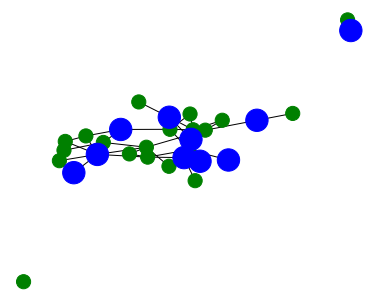

In [12]:
G = nx.erdos_renyi_graph(30, 0.1, seed=2021) 

color_map = ['green' if node<20 else 'blue' for node in G]
node_size = [200 if node <20 else 500 for node in G]

plt.figure(figsize=(5,4))
nx.draw_spring(G, node_size = node_size, node_color=color_map)

3) Find the largest connect component and the number of nodes and edges of it

4) Return the actual probability of forming edges in the original graph and its largest connected component: actual # of edges divided by the max possible number of edges

In [ ]:
#return connected components
Gcs = nx.connected_components(G)

#return the largest connected component
Gc = G.subgraph(max(Gcs, key=len))

In [13]:
# return number of nodes
n_node_G = G.number_of_nodes()
n_node_Gc = Gc.number_of_nodes()

# return number of edges
n_edge_G = G.number_of_edges()
n_edge_Gc = Gc.number_of_edges()

# calculate edge probability
def get_edge_prob(n_node, n_edge):
    max_n_edge = n_node*(n_node-1)/2
    return n_edge/max_n_edge

edge_prob_G = get_edge_prob(n_node_G, n_edge_G)
edge_prob_Gc = get_edge_prob(n_node_Gc, n_edge_Gc)

print('===== Edge probability in original graph is: {}'.format(round(edge_prob_G, 4)))
print('===== Edge probability in the largest connected component is: {}'.format(round(edge_prob_Gc, 4)))

===== Edge probability in original graph is: 0.092
===== Edge probability in the largest connected component is: 0.3333


### Bipartite networks

In [ ]:
from networkx.algorithms import bipartite

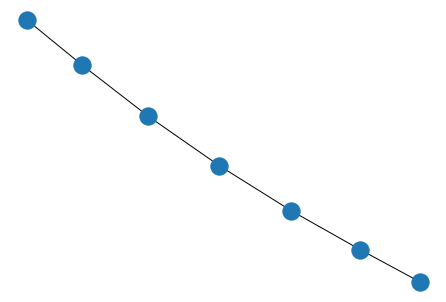

In [14]:
# build up
B = nx.Graph()
# Add nodes with the node attribute "bipartite"
B.add_nodes_from([1, 2, 3, 4], bipartite=0)
B.add_nodes_from(["a", "b", "c"], bipartite=1)
# Add edges only between nodes of opposite node sets
B.add_edges_from([(1, "a"), (1, "b"), (2, "b"), (2, "c"), (3, "c"), (4, "a")])

nx.draw(B)

In [17]:
left, right = nx.bipartite.sets(B)

# nx.draw_networkx(B, pos = nx.drawing.layout.bipartite_layout(B, left), width = 2)

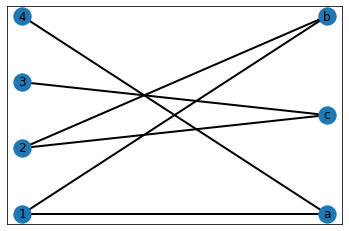

In [18]:
Image('Gb.png')

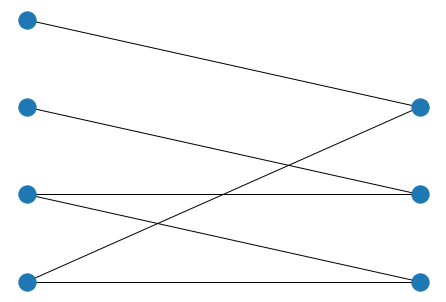

In [19]:
# can specify position as well
X, Y = nx.bipartite.sets(B)
pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate(X) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate(Y) ) # put nodes from Y at x=2
nx.draw(B, pos=pos) # use with_labels=True if latex is available

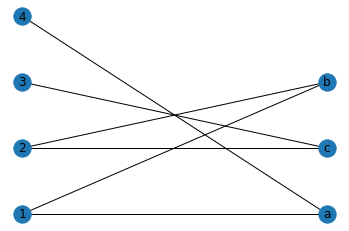

In [20]:
Image('Gb_label.png')

In [21]:
# generate a bipartite graph
Gb = nx.complete_bipartite_graph(10, 8)

### Excercise 2

1) Generate a 15 by 10 bipartite network using ```nx.complete_bipartite_graph(n1, n2)```

2) Find the maximum matching (a dictionary)

3) Plot the maximum matching as a biparte network

In [22]:
# maximum matching: largest set of edges without common vertices
# generate a bipartite graph
B = nx.complete_bipartite_graph(10, 8)
B_m_max_dict = nx.bipartite.maximum_matching(B)
B_m_max_dict

{0: 10,
 1: 11,
 2: 12,
 3: 13,
 4: 14,
 5: 15,
 6: 16,
 7: 17,
 10: 0,
 11: 1,
 12: 2,
 13: 3,
 14: 4,
 15: 5,
 16: 6,
 17: 7}

In [23]:
key_last = list(B_m_max_dict.keys())[int(len(B_m_max_dict)/2-1)]
B_m_max_dict = {key: value for key, value in B_m_max_dict.items() if key<=key_last}

In [24]:
B_m_max = nx.Graph()

# add nodes
node_left = [*B_m_max_dict.keys()]
node_right = [*B_m_max_dict.values()]

B_m_max.add_nodes_from(node_left, bipartite=0)
B_m_max.add_nodes_from(node_right, bipartite=1)

# Add edges 
edge_list = [(k, v) for k, v in B_m_max_dict.items()]
B_m_max.add_edges_from(edge_list)

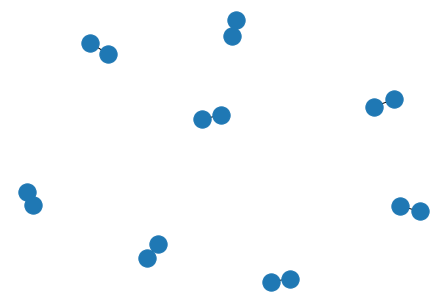

In [25]:
nx.draw(B_m_max) # use with_labels=True if latex is available

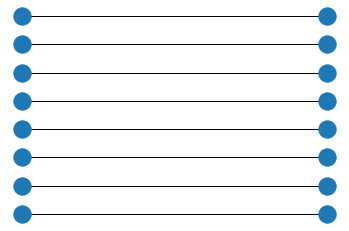

In [26]:
X, Y = set(node_left), set(node_right)
pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate(X) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate(Y) ) # put nodes from Y at x=2

plt.plot(figsize=(3,3))
nx.draw(B_m_max, pos=pos) # use with_labels=True if latex is available

In [ ]:
# get degree_centrality: the fraction of nodes it is connected to. Originally # of neighbors a node has.
# c_deg = nx.algorithms.centrality.degree_centrality(Gb)
# c_deg

### A taste of graph_tool 

graph_tool is much faster: core data structures and algorithms are implemented in C++

In [27]:
import time

n_node = 1000        # try 2000 or 500 and see networkx can handle it on your laptop

In [28]:
# Using networkx
start = time.time()
G = nx.complete_graph(n_node) 
end = time.time()
print(end - start)

0.40145230293273926


In [29]:
# Using graph_tool
from graph_tool import generation

start = time.time()
g = gt.complete_graph(n_node)
end = time.time()
print(end - start)

0.053818702697753906


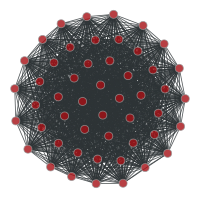

In [30]:
# plot this complete graph using graph_tool
g = gt.complete_graph(50)
pos = gt.sfdp_layout(g, cooling_step=0.95, epsilon=1e-2)
gt.graph_draw(g, pos=pos, output_size=[100,100],output="complete.png")
Image('complete.png')

### Comparison on other aspects

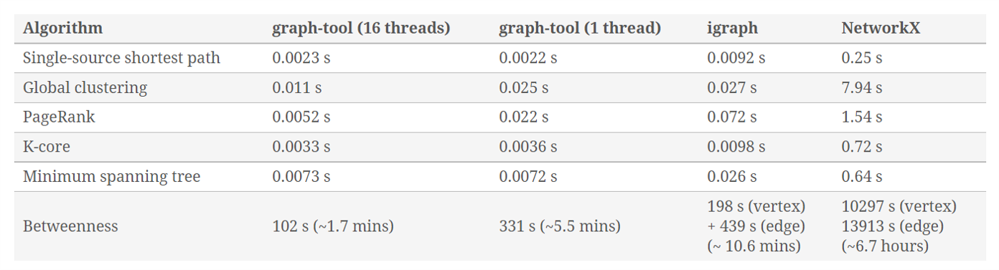

In [31]:
Image('gt_vs_networkx.png')

### Random graph generated according to degree distribution and edge probability

In [32]:
# uses rejection sampling to sample from the distribution p(k) ~ 1/k, up to a max value
def sample_k(max):
    accept = False
    while not accept:
        k = np.random.randint(1,max)
        accept = np.random.random() < 1.0/k
    return k

# the edge probability indirectly determined by the degree correlation: p(i,k) ~ 1/(1+abs(i-k))
g = gt.random_graph(800, lambda: sample_k(max=40), model="probabilistic-configuration",
                    edge_probs=lambda i, k: 1.0 / (1 + abs(i - k)), directed=False,
                    n_iter=100)  # total number of edges randomly chosen for a swap attempt 

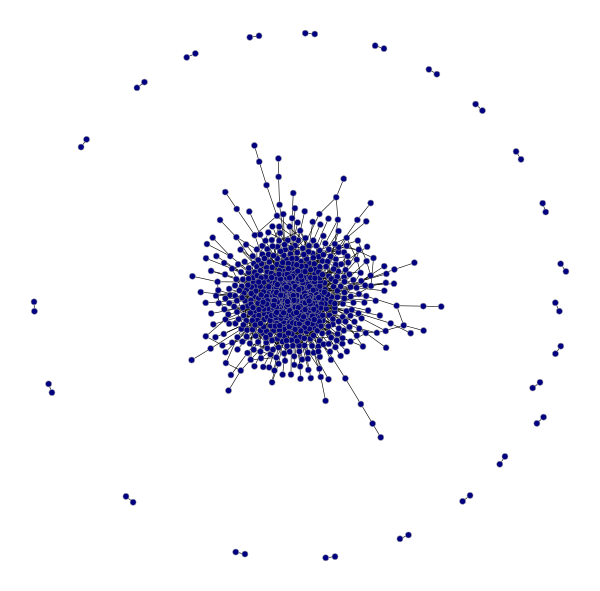

In [33]:
fname = '../output/net_dg.png'
gt.graph_draw(g, vertex_fill_color='navy', edge_color="black", output_size=[300,300], output=fname)
Image(fname)

## Excercise 3 Generate random graph according to given degree distribution and edge probability

1) 500 node random network with a degree distribuiton: Poison(mean=3), max_degree = 20, min_degree = 1

pdf of Poison: p(k)= mean**k*math.exp(-mean)/math.factorial(k)

2) Edge probability determined by the difference in the degrees of two nodes, i,j: 1/sqrt(2*pi)*exp(abs(i-j-2)^/2)

3) Other params are the same as the proceeding example

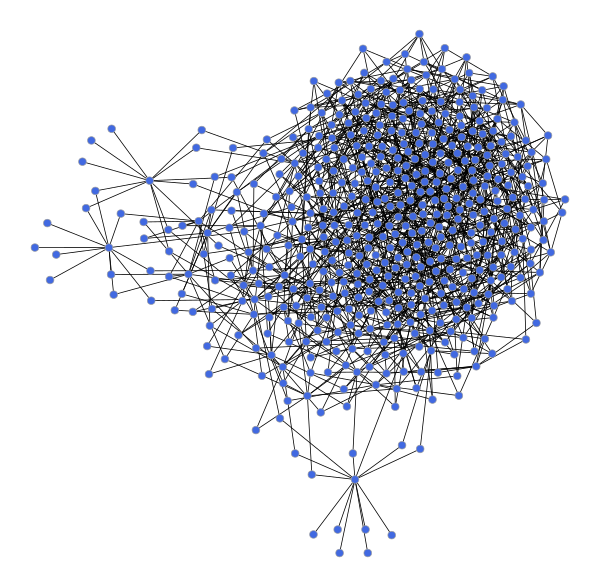

In [34]:
import math

def sample_k(max, min, mean):
    accept = False
    while not accept:
        k = np.random.randint(min,max)
        prob = mean**k*math.exp(-mean)/math.factorial(k)
        accept = np.random.random() < prob
    return k

g = gt.random_graph(500, lambda: sample_k(max=20, min=1, mean=5), model="probabilistic-configuration",
                    edge_probs=lambda i, j: 1/math.sqrt(2*math.pi)*math.exp(abs(i-j)**2/2), directed=False,
                    n_iter=100)  # total number of edges randomly chosen for a swap attempt 

# draw
fname = '../output/exc3.png'
gt.graph_draw(g, vertex_fill_color='royalblue', edge_color="black", output_size=[300,300], output=fname)
Image(fname)

### Stochastic Block Model

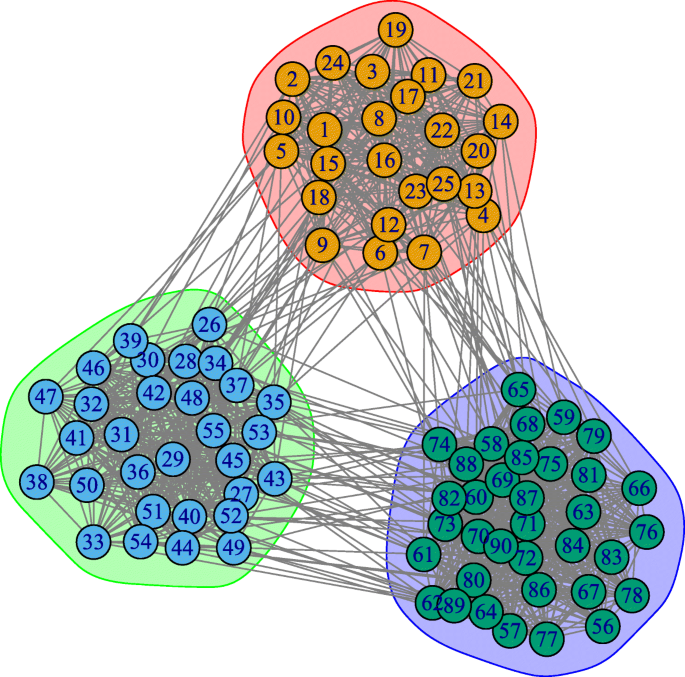

In [35]:
Image('sbm.png', width=300, height=300) 
# source:https://appliednetsci.springeropen.com/articles/10.1007/s41109-019-0232-2/figures/1

### Using networkx

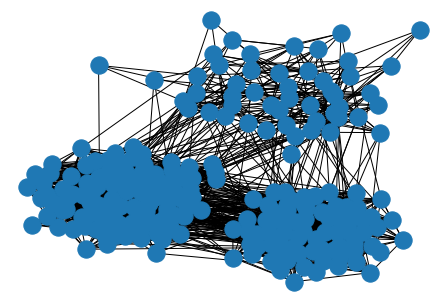

In [36]:
sizes = [75, 50, 100]
probs = [[0.25, 0.01, 0.02], [0.01, 0.15, 0.01], [0.02, 0.01, 0.20]] # within and between block edge probabilities
G_sbm = nx.stochastic_block_model(sizes, probs, seed=2021)
nx.draw(G_sbm)

### Using graph_tool

In [38]:
# A stochastic block model with 5 blocks
# the probability of forming edges
def edge_prob(a, b):
    prob_in = 0.99
    if a == b:
        return prob_in
    else:
        return (1-prob_in)

In [39]:
from random import randint
n_blk = 5
fname = "../output/blockmodel.png"
g, bm = gt.random_graph(500, lambda: np.random.poisson(n_blk), directed=False,
                        model="blockmodel",
                        block_membership=lambda: randint(1,n_blk),
                        edge_probs=edge_prob)
gt.graph_draw(g, vertex_fill_color=bm, edge_color="black", output_size=[300,300], output=fname)

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7fbea4fba400, at 0x7fbea4fbaf10>

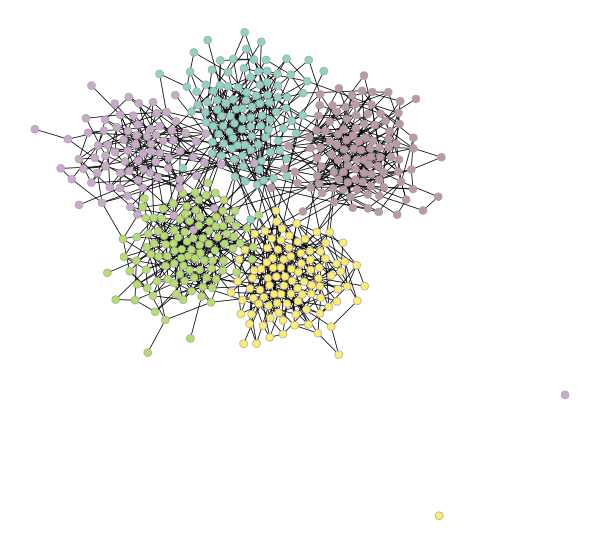

In [40]:
Image(fname)

### Nuclear reaction networks. Directed and unweighted network.

```Jiang C, Szymanski BK, Lian J, Havlin S, Gao J. Nuclear reaction network unveils novel reaction patterns based on stellar energies. New Journal of Physics. 2021 Aug 19;23(8):083035.```

#### Import graph and layout

In [41]:
graph_fname = 'nuc.xml.gz'
layout_fname = 'force4.csv'

The data look like:

<?xml version="1.0" encoding="UTF-8"?>
<graphml xmlns="http://graphml.graphdrawing.org/xmlns"
         xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance"
         xsi:schemaLocation="http://graphml.graphdrawing.org/xmlns http://graphml.graphdrawing.org/xmlns/1.0/graphml.xsd">

  <!-- property keys -->
  <key id="key0" for="node" attr.name="label" attr.type="string" />
  <key id="key1" for="edge" attr.name="mode" attr.type="vector_float" />
  <key id="key2" for="node" attr.name="pos" attr.type="vector_float" />
  <key id="key3" for="node" attr.name="proton" attr.type="float" />

  <graph id="G" edgedefault="directed" parse.nodeids="canonical" parse.edgeids="canonical" parse.order="nodesfirst">

   <!-- graph properties -->

   <!-- vertices -->
    <node id="n0">
      <data key="key0">he3</data>
      <data key="key2">0x1p+0, 0x1p+1</data>
      <data key="key3">0x1p+1</data>
    </node>
    <node id="n1">
      <data key="key0">he6</data>
      <data key="key2">0x1p+2, 0x1p+1</data>
      <data key="key3">0x1p+1</data>
    </node>
        ...
 
   <!-- edges -->
    <edge id="e0" source="n0" target="n6995">
      <data key="key1">0x1p+0, 0x0p+0</data>
    </edge>
    <edge id="e1" source="n0" target="n9">
      <data key="key1">0x1p+1, 0x1p+1</data>
    </edge>
      
      ...
      
    </edge>

  </graph>
</graphml>

In [42]:
import pandas as pd

layout_df = pd.read_csv(layout_fname)
layout_df.head(5)

,x,y,r,g,b,nuclide
0,1023.025998,3692.759578,31,119,180,Po273
1,4367.095388,4518.490648,174,199,232,Sg276
2,5712.479430,2015.262104,255,127,14,Bk306
3,2953.897381,1631.564665,255,187,120,Tb166
4,1811.046242,3201.716525,44,160,44,U235


In [43]:
def show_forcedirected_nucnet(graph_fname, layout_fname='draft/force4.csv', output_fname='nrnet.pdf'):
    """
    :param str graph_fname: input graph-tool graph
    :param str layout_fname: position file
    """
    coordinates = pd.read_csv(layout_fname)  # usually not available. Determined by trial and error. 

    graph = gt.load_graph(graph_fname)

    n = graph.num_vertices()
    degs = graph.get_out_degrees(range(n))
    
    print('===== The # of vertices is: {} ====='.format(n))
    print('===== The # of edges is: {} ====='.format(graph.num_edges()))

    norm = plt.Normalize()
    cmap = plt.get_cmap('Set2')(norm(range(19)))

    vc = graph.new_vp('vector<float>')
    szs = graph.new_vp('float')
    grp = graph.new_vp('int')

    if 'proton' not in graph.vp:
        protons = graph.new_vp('int')
        pos = graph.vp['pos']
        for v in range(n):
            protons[v] = pos[v][1]
    else:
        protons = graph.vp['proton']

    pos = graph.new_vp('vector<double>')
    labels = graph.new_vp('string')
    gt.map_property_values(graph.vertex_properties['label'], labels, str.capitalize)
    for v in range(n):
        k = degs[v]
        grp[v] = protons[v]
        vc[v] = cmap[k]
        szs[v] = 20
        selected = coordinates[coordinates.nuclide == labels[v]]
        if selected.shape[0] > 0:
            pos[v] = [selected.x.values[0], selected.y.values[0]]

    categories = {}
    modes = graph.edge_properties['mode']
    for e in graph.edges():
        mode = modes[e]
        if mode not in categories:
            categories[mode] = len(categories)

    ec = graph.new_ep('vector<double>')
    alpha = 0.5
    ncomb = len(categories)
    
    cmap = plt.get_cmap('viridis')(norm(range(ncomb)), alpha=alpha)

    for e in graph.edges():
        mode = modes[e]
        ind = categories[mode]
        ec[e] = cmap[ind]
    text_rot = graph.new_vp('double')
    for v in graph.vertices():
        if pos[v][0] > 0:
            text_rot[v] = math.atan(pos[v][1] / pos[v][0])
        else:
            text_rot[v] = math.pi + math.atan(pos[v][1] / pos[v][0])
    
    # draw and save
    print('\n===== Start to plot the network =====')
    gt.graph_draw(graph, pos=pos, vertex_fill_color=vc, vertex_color=vc,
                  vertex_size=16,
                  vertex_text=labels,
                  vertex_text_rotation=text_rot,
                  vertex_text_position=1,
                  vertex_font_size=10,
                  edge_color=ec,
                  # bg_color=[0, 0, 0, 1],
                  output_size=[4000, 4000],  # output_size=[8000, 8000],
                  output=output_fname)
    
    print('\n===== Complete plotting the network =====')

In [44]:
output_fname = '../output/nrnet.pdf'  # Can save as a .png file for faster view
show_forcedirected_nucnet(graph_fname, layout_fname, output_fname)

===== The # of vertices is: 8042 =====
===== The # of edges is: 77331 =====

===== Start to plot the network =====

===== Complete plotting the network =====


**Note:** Better to open the .png file outside jupyter-notebook. Try open it here use the following code and you'll see why. **The following code does NOT work if the figure is saved as PDF file.**

In [45]:
Image(output_fname)

ValueError: Cannot embed the 'pdf' image format

### Subgraph with edges (reactions) belonging to the specific reaction mode

In [46]:
def mode_network(G,mode=(1,0)):
    '''
    Subgraph with edges (reactions) belonging to the specific mode
    
    Parameters:
    -----------
    G:          original network with all reaction modes included
    mode:       specific reaction mode to construct the subgraph
    
    Returns:
    ----------
    subgraph with all edges of the specific reaction mode
    '''
    # find largest connect component
    gcc = G.subgraph(max(nx.connected_components(G), key=len))

    sG=nx.Graph()
    for k,mode in nx.get_edge_attributes(gcc,'mode').items():
        if mode != (-1,0):
            continue
        sG.add_edge(k[0],k[1])
    return sG

In [47]:
nxG=nx.read_gpickle('G_logrcut_brk.net')
sG=mode_network(nxG,mode=(-1,0))

nod_dict={u:i for i,u in enumerate(list(nxG.nodes()))}

gtG=gt.Graph()
modes=gtG.new_ep('string')
for k,mode in nx.get_edge_attributes(nxG,'mode').items():
    u,v=nod_dict[k[0]],nod_dict[k[1]]
    e=gtG.add_edge(u,v)
    modes[e]=str(mode)

In [49]:
nxG=nx.read_gpickle('G_logrcut_after_brk.net')
sG=mode_network(nxG,mode=(-1,0))

nod_dict={u:i for i,u in enumerate(list(sG.nodes()))}

gtG=gt.Graph()
for k in sG.edges():
    u,v=nod_dict[k[0]],nod_dict[k[1]]
    e=gtG.add_edge(u,v)

In [50]:
pos_sfdp= gt.sfdp_layout(gtG,p=5)

In [51]:
output_fname = '../output/G_logrcut_brk_sfdp.png'
gt.graph_draw(gtG,pos=pos_sfdp,vertex_size=20,output_size=[6000,6000],output=output_fname)

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7fbf3c56da60, at 0x7fbea45754c0>

In [52]:
# Open the plot
Image(output_fname, width=600, height=600)

In [53]:
output_fname = '../output/GraphLogrcutAfterBrkMode-1-0.png'
gt.graph_draw(gtG,pos=pos_sfdp,vertex_size=5,vertex_color='#ffffff',vertex_fill_color='#ffffff',
              edge_color='#756bb1',edge_pen_width=1.5,bg_color=[0,0,0,40],
              output_size=[1000,1000],output=output_fname)

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7fbf3c56da60, at 0x7fbea462a5b0>

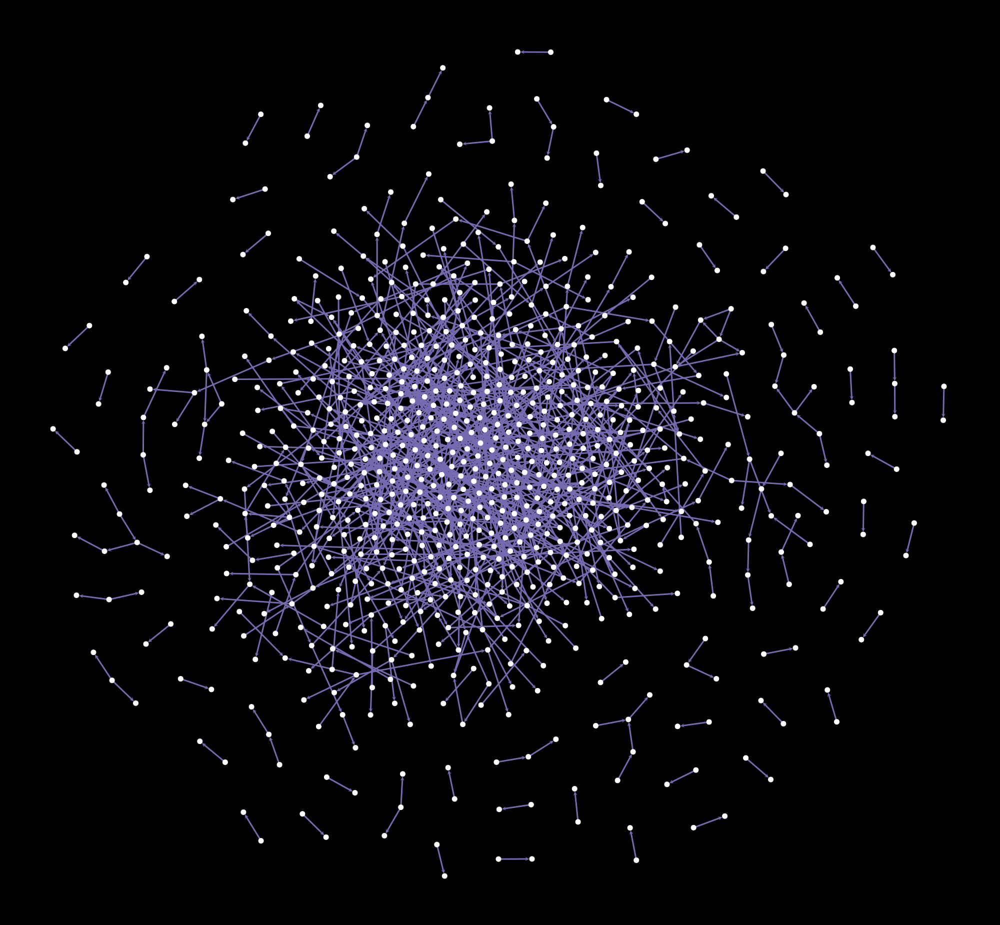

In [54]:
# Open the plot
Image(output_fname, width=600, height=600)

In [55]:
def draw_graph(T9,log_rate_cutoff,reuse_layout=False,Repulsive=2.0):
    nxG=nx.read_gpickle('T{0}_LogR{1}.net'.format(T9,log_rate_cutoff))
    sG=mode_network(nxG,mode=(-1,0))

    nod_dict={u:i for i,u in enumerate(list(sG.nodes()))}

    gtG=gt.Graph()
    for k in sG.edges():
        u,v=nod_dict[k[0]],nod_dict[k[1]]
        e=gtG.add_edge(u,v)
    
    fnm='Layout_T{0}_LogR{1}.pkl'.format(T9,log_rate_cutoff)
    if reuse_layout and os.path.exists(fnm):
        with open(fnm,'rb') as file:
            ret=pickle.load(file)
        pos_sfdp = gtG.new_vp('vector<double>')
        for i in range(len(nod_dict)):
            pos_sfdp[i] = ret[i]
    else:
        pos_sfdp= gt.sfdp_layout(gtG,p=Repulsive)
        with open(fnm,'wb') as file:
            pickle.dump(pos_sfdp,file)

    output_fname = '../output/NN_T{0}_LogR{1}.png'.format(T9,log_rate_cutoff)
    gt.graph_draw(gtG,pos=pos_sfdp,vertex_size=4,vertex_color='#ffffff',vertex_fill_color='#ffffff',
                  edge_color='#756bb1',edge_pen_width=1,bg_color=[0,0,0,40],
                  output_size=[800,400],output=output_fname)

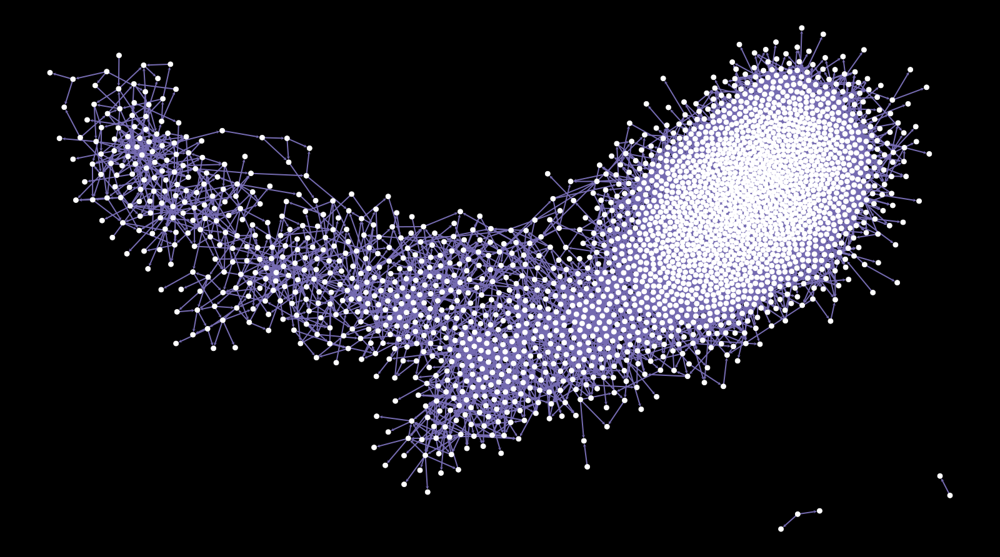

In [56]:
draw_graph(1.0,-100,reuse_layout=True,Repulsive=3.6)
Image('../output/NN_T1.0_LogR-100.png')

In [57]:
def visualize_network(net,Repulsive=2):
    '''
    Visualize network
    
    Parameters:
    ----------
    net:       name of the complete network
    Repulsive: repel force between nodes
    '''
    if net in ['net6','net8']:
        dyn = 'ecology'
    elif net in ['mec','tya']:
        dyn = 'regulatory'
    elif net in ['email','arenas-email']:
        net = 'arenas-email'
        dyn = 'epidemic'
    elif net in ['facebook','ego-facebook']:
        net = 'ego-facebook'
        dyn = 'epidemic'

    nxG=nx.read_edgelist('{}.edges.csv'.format(net),nodetype=int,data=False,delimiter=',')
    nod_dict={u:i for i,u in enumerate(list(nxG.nodes()))}

    gtG=gt.Graph(directed=False)
    for k in nxG.edges():
        u,v=nod_dict[k[0]],nod_dict[k[1]]
        e=gtG.add_edge(u,v)

    pos_sfdp= gt.sfdp_layout(gtG,p=Repulsive)
    fnm='../output/{}.png'.format(net.capitalize())
    gt.graph_draw(gtG,pos=pos_sfdp,vertex_size=5,vertex_color='#ffffff',vertex_fill_color='#ffffff',
                  edge_color='#756bb1',edge_pen_width=0.5,bg_color=[0,0,0,40],
                  output_size=[1000,1000],output=fnm)


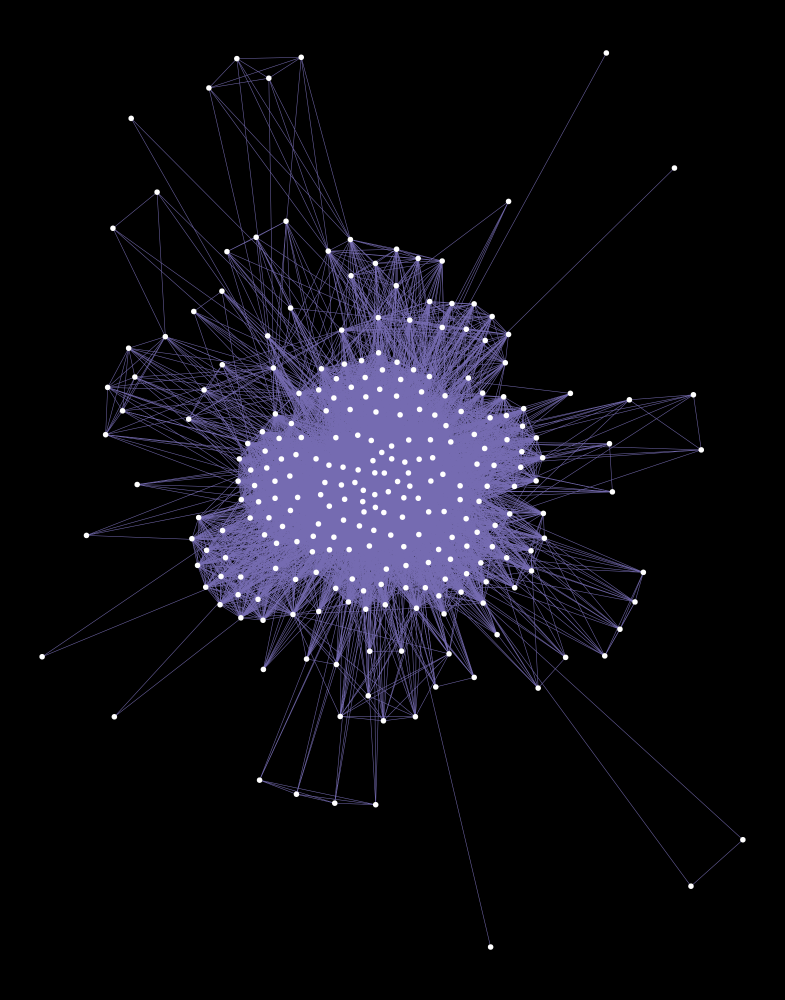

In [58]:
visualize_network(net='net6',Repulsive=1.5)
Image('../output/net6.png')

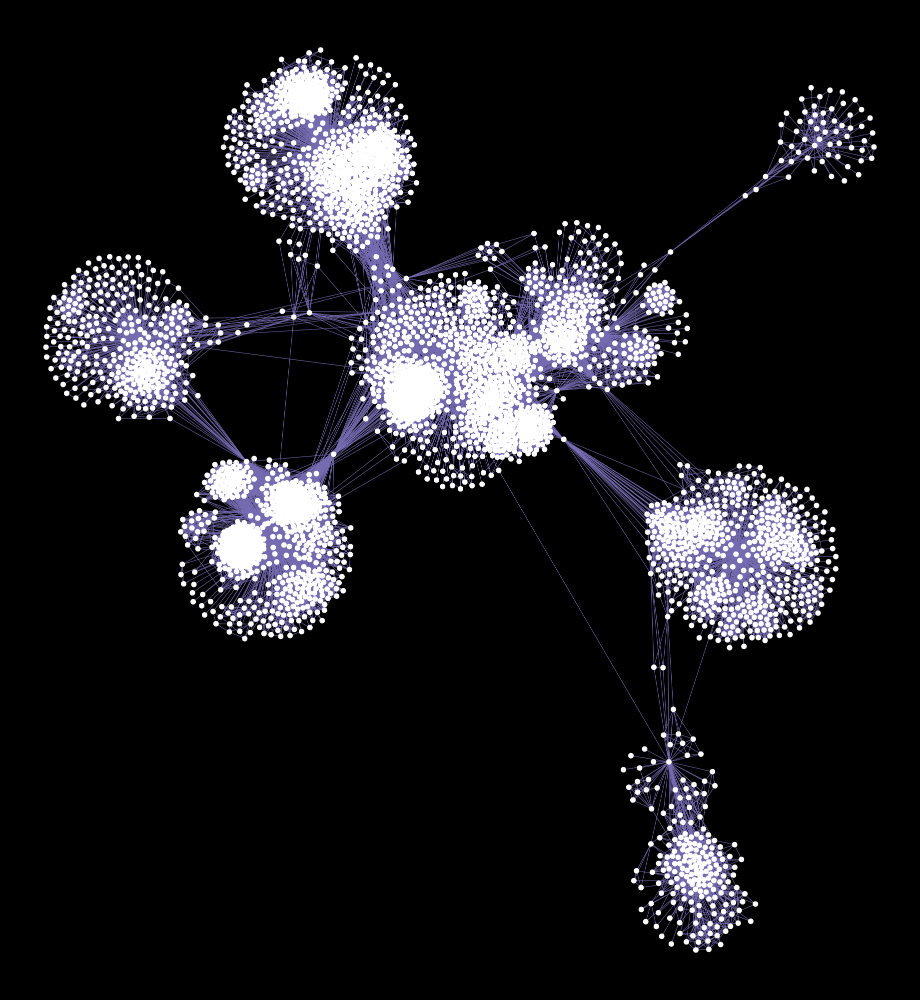

In [59]:
visualize_network(net='facebook',Repulsive=2.1)
Image('../output/Ego-facebook.png')

In [ ]:
# data=[]
# for i,u in enumerate(list(sG.nodes())):
#     loc=nuc[nuc.nuclide == u]
#     entry=list(loc.iloc[0])[:5]
#     entry.extend([ret[i][0],ret[i][1]])
#     data.append(entry)
# df=pd.DataFrame(data,columns=['nuclide','n','p','kin','kout','x','y'])
# df.to_csv('..output/Coordinates_T{0}_LogR{1}.csv'.format(T9,log_rate_cutoff),index=False)